<a href="https://colab.research.google.com/github/shahim001/My_project/blob/main/SER_001.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install python_speech_features

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for python_speech_features: filename=python_speech_features-0.6-py3-none-any.whl size=5870 sha256=7f1967b31d38fc84f360adb6dab50059a77ed45160387d0cdddea177012f1549
  Stored in directory: /root/.cache/pip/wheels/5a/9e/68/30bad9462b3926c29e315df16b562216d12bdc215f4d240294
Successfully built python_speech_features


In [ ]:
!pip install noisereduce

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install SpeechRecognition

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 32.8/32.8 MB 44.5 MB/s eta 0:00:00


In [ ]:
#Install all the Reqiuired Libraries and Packages
import os
import glob
from tqdm import tqdm
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import wavfile
from python_speech_features import mfcc , logfbank
import librosa as lr
import os, glob, pickle
import librosa
from scipy import signal
import noisereduce as nr
from glob import glob
import librosa
get_ipython().magic('matplotlib inline')
#All the Required Packages and Libraies are installed.
import soundfile
from tensorflow.keras.layers import Conv2D,MaxPool2D, Flatten, LSTM
from keras.layers import Dropout,Dense,TimeDistributed
from keras.models import Sequential
from keras.utils import to_categorical
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score

In [ ]:
#Loading the required RAVDESS DataSet with length of 1440 Audio Files
os.listdir(path='/content/drive/MyDrive/speech-emotion-recognition')
def getListOfFiles(dirName):
    listOfFile=os.listdir(dirName)
    allFiles=list()
    for entry in listOfFile:
        fullPath=os.path.join(dirName, entry)
        if os.path.isdir(fullPath):
            allFiles=allFiles + getListOfFiles(fullPath)
        else:
            allFiles.append(fullPath)
    return allFiles

dirName = '/content/drive/MyDrive/speech-emotion-recognition'
listOfFiles = getListOfFiles(dirName)
len(listOfFiles)

1440

In [ ]:
#Use the Speech-Recognition API to get the Raw Text from Audio Files, Though Speech Recognition
#is less strong for large chunk of files , so used Error Handling , where when it is not be able to
#produce the text of a particular Audio File it prints the statement 'error'.Just for understanding Audio
import speech_recognition as sr
r=sr.Recognizer()
for file in range(0 , len(listOfFiles) , 1):
    with sr.AudioFile(listOfFiles[file]) as source:
        audio = r.listen(source)
        try:
            text = r.recognize_google(audio)
            print(text)
        except:
            print('error')

dogs are sitting by the door
kids are talking by the door
cancel talking by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
kids are talking by the door
kids are talkin by the door
kids are talking by the door
kids are talking by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
kids talking by the door
dogs are sitting by the door
kids are talking by the door
dogs are sitting by the door
kids are talking by the door
dogs are sitting by the door
kids are talking by the door
dogs are sitting by the door
kids are talking by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
dogs are sitting by the door
dogs are sitting by the door
dogs are sitting by the door
kids are talking by the door
dogs are sitting by t

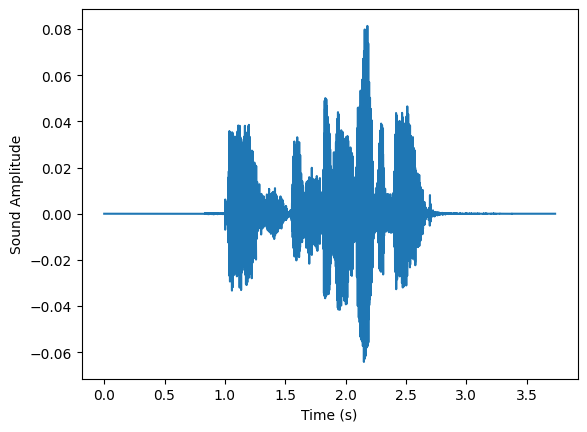

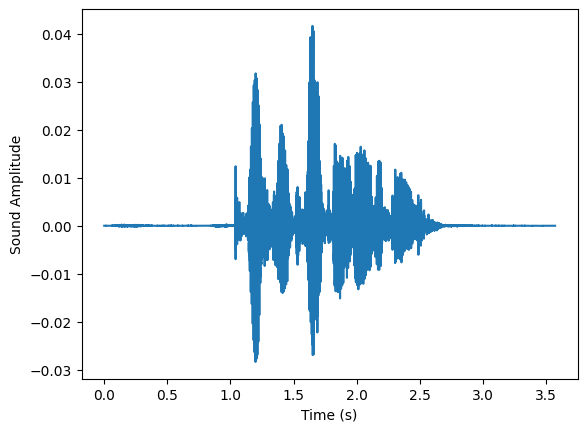

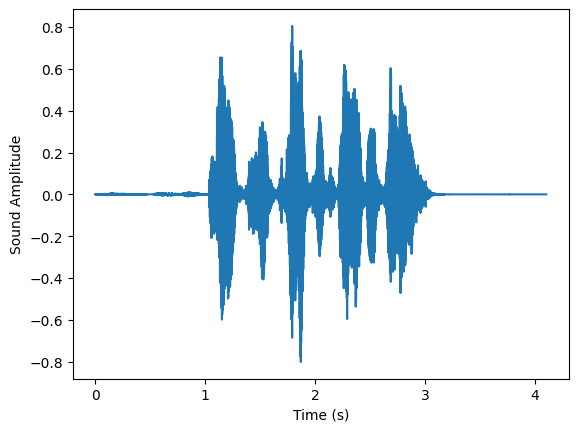

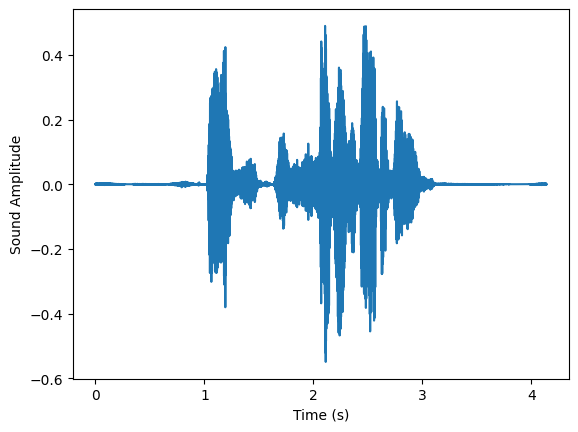

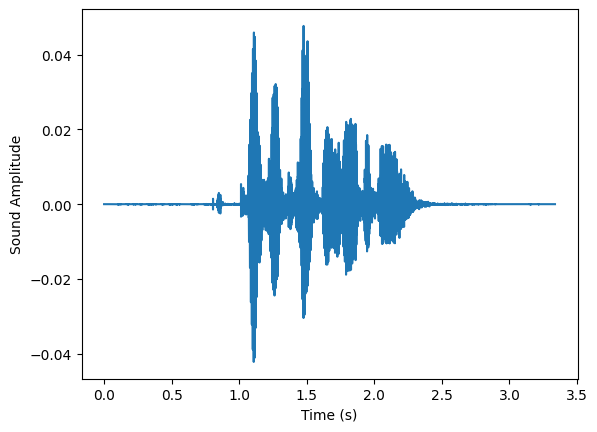

...

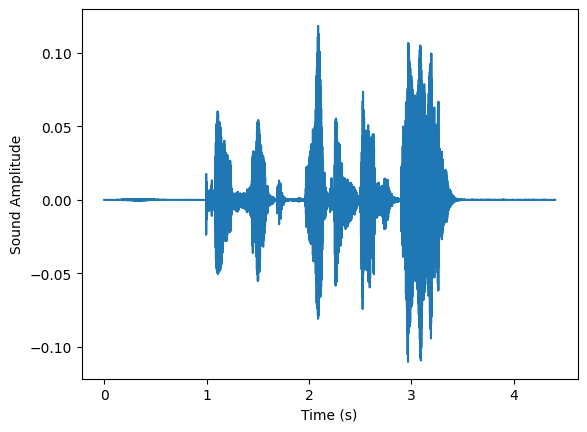

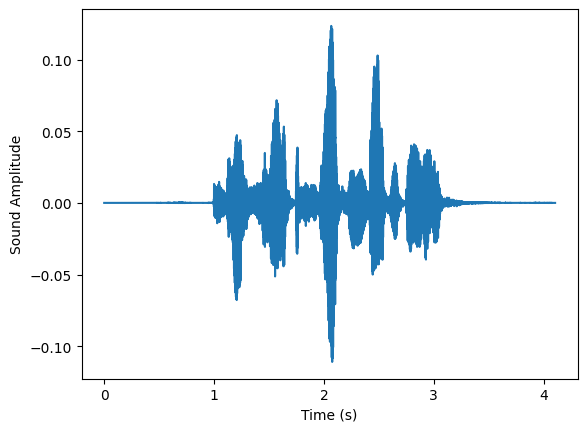

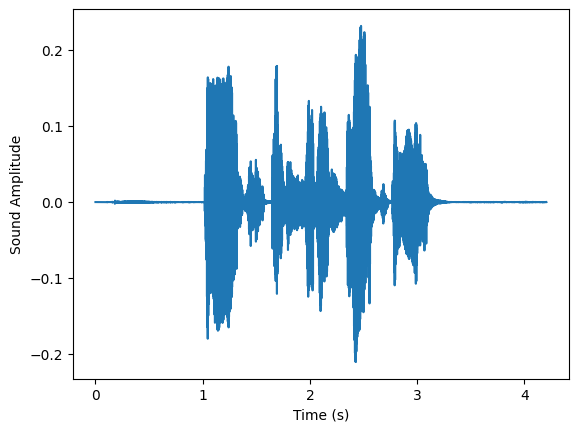

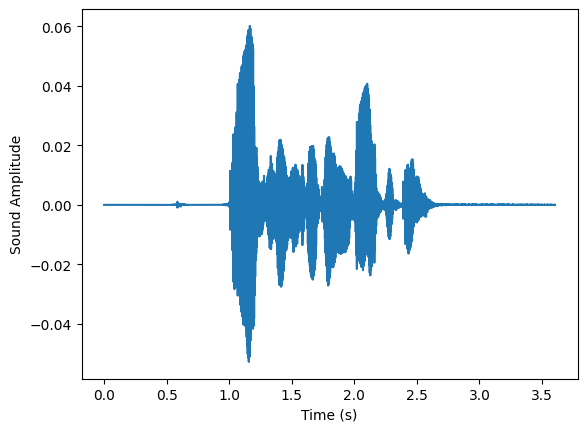

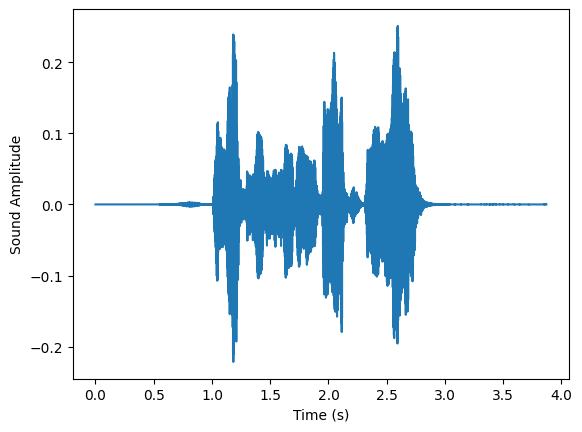

In [ ]:
#Plotting the Basic Graphs for understanding of Audio Files :
for file in range(0 , len(listOfFiles) , 1):
    audio , sfreq = lr.load(listOfFiles[file])
    time = np.arange(0 , len(audio)) / sfreq

    fig ,ax = plt.subplots()
    ax.plot(time , audio)
    ax.set(xlabel = 'Time (s)' , ylabel = 'Sound Amplitude')
    plt.show()


In [ ]:
#Now Cleaning Step is Performed where:
#DOWN SAMPLING OF AUDIO FILES IS DONE  AND PUT MASK OVER IT AND DIRECT INTO CLEAN FOLDER
#MASK IS TO REMOVE UNNECESSARY EMPTY VOICES AROUND THE MAIN AUDIO VOICE
def envelope(y , rate, threshold):
    mask=[]
    y=pd.Series(y).apply(np.abs)
    y_mean = y.rolling(window=int(rate/10) ,  min_periods=1 , center = True).mean()
    for mean in y_mean:
        if mean>threshold:
            mask.append(True)
        else:
            mask.append(False)
    return mask

In [ ]:
#The clean Audio Files are redirected to Clean Audio Folder Directory
import glob,pickle
for file in tqdm(glob.glob(r'/content/drive/MyDrive/speech-emotion-recognition/Actor_*/*.wav')):
    file_name = os.path.basename(file)
    signal , rate = librosa.load(file, sr=16000)
    mask = envelope(signal,rate, 0.0005)
    wavfile.write(filename= r'/content/drive/MyDrive/clean_speech//'+str(file_name), rate=rate,data=signal[mask])

100%|██████████| 1440/1440 [06:04<00:00,  3.95it/s]


In [ ]:
#Feature Extraction of Audio Files Function
#Extract features (mfcc, chroma, mel) from a sound file
def extract_feature(file_name, mfcc, chroma, mel):
    with soundfile.SoundFile(file_name) as sound_file:
        X = sound_file.read(dtype="float32")
        sample_rate=sound_file.samplerate
        if chroma:
            stft=np.abs(librosa.stft(X))
        result=np.array([])
        if mfcc:
            mfccs=np.mean(librosa.feature.mfcc(y=X, sr=sample_rate, n_mfcc=40).T, axis=0)
        result=np.hstack((result, mfccs))
        if chroma:
            chroma=np.mean(librosa.feature.chroma_stft(S=stft, sr=sample_rate).T,axis=0)
        result=np.hstack((result, chroma))
        if mel:
            mel=np.mean(librosa.feature.melspectrogram(y=X, sr=sample_rate).T,axis=0)
        result=np.hstack((result, mel))
    return result

In [ ]:
#Emotions in the RAVDESS dataset to be classified Audio Files based on .
emotions={
  '01':'neutral',
  '02':'calm',
  '03':'happy',
  '04':'sad',
  '05':'angry',
  '06':'fearful',
  '07':'disgust',
  '08':'surprised'
}
#These are the emotions User wants to observe more :
observed_emotions=['calm', 'happy', 'fearful', 'disgust']

In [ ]:
#Load the data and extract features for each sound file
from glob import glob
import os
import glob
def load_data(test_size=0.25):
    x,y=[],[]
    answer = 0
    for file in glob.glob(r'/content/drive/MyDrive/clean_speech//*.wav'):
        file_name=os.path.basename(file)
        emotion=emotions[file_name.split("-")[2]]
        if emotion not in observed_emotions:
            answer += 1
            continue
        feature=extract_feature(file, mfcc=True, chroma=True, mel=True)
        x.append(feature)
        y.append([emotion,file_name])
    return train_test_split(np.array(x), y, test_size=test_size, random_state=9)

In [ ]:
#Split the dataset
import librosa
import numpy as np
x_train,x_test,y_trai,y_tes=load_data(test_size=0.25)
print(np.shape(x_train),np.shape(x_test), np.shape(y_trai),np.shape(y_tes))
y_test_map = np.array(y_tes).T
y_test = y_test_map[0]
test_filename = y_test_map[1]
y_train_map = np.array(y_trai).T
y_train = y_train_map[0]
train_filename = y_train_map[1]
#print(np.shape(y_train),np.shape(y_test))
#print(*test_filename,sep="\n")


(576, 180) (192, 180) (576, 2) (192, 2)


In [ ]:
#Get the shape of the training and testing datasets
print((x_train.shape[0], x_test.shape[0]))
print('\n')
print((x_train[0], x_test[0]))
#Get the number of features extracted
print(f'Features extracted: {x_train.shape[1]}')

(576, 192)


(array([-4.05897827e+02,  7.59623260e+01, -3.60694838e+00,  1.64484005e+01,
       -7.53916216e+00, -9.67375565e+00, -3.21918716e+01, -3.68890786e+00,
       -1.41066017e+01, -5.71136618e+00, -1.15061712e+01, -7.23610544e+00,
       -1.00668106e+01, -8.44826603e+00, -6.85328913e+00, -6.38396311e+00,
       -3.88641882e+00, -4.88894367e+00, -1.01537962e+01, -7.48883629e+00,
       -5.12696362e+00, -7.47472763e+00, -4.34835196e+00, -6.88781881e+00,
       -5.97480917e+00, -1.89550543e+00, -4.51205969e+00, -2.69815087e+00,
       -4.75712967e+00, -2.64336610e+00, -4.19932413e+00, -2.42586195e-01,
       -3.39110398e+00, -1.64756465e+00, -4.21201658e+00,  2.15766931e+00,
        3.43493605e+00,  4.81584740e+00,  2.66327715e+00,  1.74846306e-01,
        6.48283780e-01,  6.21501982e-01,  5.95932245e-01,  6.20233834e-01,
        7.35995770e-01,  6.79959238e-01,  6.56204462e-01,  6.59135282e-01,
        6.64070606e-01,  6.16727412e-01,  6.38695538e-01,  6.79102957e-01,
        2.1

In [ ]:
# Initialize the Multi Layer Perceptron Classifier
model=MLPClassifier(alpha=0.01, batch_size=256, epsilon=1e-08, hidden_layer_sizes=(300,), learning_rate='adaptive', max_iter=500)

In [ ]:
#Train the model
model.fit(x_train,y_train)

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [ ]:
import pickle
#writing diffenernt model files to file
with open('modelForPrediction.sav', 'wb') as f:
  pickle.dump(model, f)

In [ ]:
filename = 'modelForPrediction.sav'
loaded_model = pickle.load(open(filename, 'rb')) #loading the model file from storage

feature = extract_feature('/content/drive/MyDrive/speech-emotion-recognition/Actor_24/03-01-01-01-01-01-24.wav',mfcc=True,chroma=True,mel=True)

feature = feature.reshape(1,-1)

prediction = loaded_model.predict(feature)
prediction

array(['disgust'], dtype='<U7')

In [ ]:
with open(filename, 'rb') as file:
    Emotion_Voice_Detection_Model = pickle.load(file)

Emotion_Voice_Detection_Model

MLPClassifier(alpha=0.01, batch_size=256, hidden_layer_sizes=(300,),
              learning_rate='adaptive', max_iter=500)

In [ ]:
#predicting :
y_pred=Emotion_Voice_Detection_Model.predict(x_test)
y_pred

array(['disgust', 'disgust', 'happy', 'calm', 'fearful', 'calm', 'calm',
       'fearful', 'calm', 'disgust', 'calm', 'calm', 'happy', 'disgust',
       'fearful', 'disgust', 'calm', 'happy', 'fearful', 'disgust',
       'calm', 'fearful', 'fearful', 'happy', 'calm', 'fearful',
       'fearful', 'disgust', 'calm', 'fearful', 'disgust', 'disgust',
       'calm', 'calm', 'disgust', 'calm', 'disgust', 'happy', 'fearful',
       'fearful', 'calm', 'fearful', 'disgust', 'calm', 'disgust',
       'disgust', 'happy', 'happy', 'calm', 'happy', 'calm', 'happy',
       'disgust', 'calm', 'calm', 'happy', 'fearful', 'fearful', 'happy',
       'calm', 'fearful', 'happy', 'calm', 'disgust', 'calm', 'disgust',
       'disgust', 'calm', 'happy', 'calm', 'fearful', 'disgust', 'calm',
       'happy', 'fearful', 'happy', 'calm', 'fearful', 'fearful',
       'fearful', 'disgust', 'disgust', 'calm', 'disgust', 'calm', 'calm',
       'fearful', 'happy', 'disgust', 'calm', 'calm', 'fearful',
       'disgust

In [ ]:
#Store the Prediction probabilities into CSV file
import numpy as np
import pandas as pd
y_pred1 = pd.DataFrame(y_pred, columns=['predictions'])
y_pred1['file_names'] = test_filename
print(y_pred1)
y_pred1.to_csv('predictionfinal.csv')

    predictions                file_names
0       disgust  03-01-07-02-01-02-12.wav
1       disgust  03-01-03-01-01-01-24.wav
2         happy  03-01-03-02-02-02-02.wav
3          calm  03-01-02-02-01-02-20.wav
4       fearful  03-01-06-02-01-01-04.wav
..          ...                       ...
187        calm  03-01-02-02-01-01-02.wav
188       happy  03-01-03-02-01-01-09.wav
189     disgust  03-01-07-01-02-02-13.wav
190        calm  03-01-02-01-01-01-03.wav
191        calm  03-01-02-02-02-01-21.wav

[192 rows x 2 columns]


In [ ]:
print('Accuracy Score : ',accuracy_score(y_test, y_pred) )

Accuracy Score :  0.7760416666666666
